In [ ]:
!pip install -r ../ResNet/requirements-resnet.txt
!pip install -q 'git+https://github.com/facebookresearch/segment-anything.git'
!pip install supervision

In [3]:
#from resnet import predict_classification_utils
from sam import sam_utils
from sam.utils import load_sam_model,occ_mem_info,filter_nested_similar_masks,apply_mask_and_create_image,save_segmentation_results,update_annotations,open_config_annotations,save_config_annotations,get_segment_mask,process_image_with_filter


import os
import torch
import torchvision
import sys
from segment_anything import sam_model_registry, SamAutomaticMaskGenerator, SamPredictor
import cv2
import supervision as sv
import numpy as np
from PIL import Image
import shutil
from tqdm.auto import tqdm
import json
from typing import Any
from datetime import datetime
import time
import supervision as sv

In [4]:
torch.cuda.empty_cache()
DEVICE = torch.device('cuda:0' if torch.cuda.is_available() else 'cpu')
sam,mask_generator =load_sam_model("vit_l",os.path.join("sam","weights"), DEVICE )

In [5]:
file = 'sample_data/bin201.jpg'


In [6]:
from sam.utils import calculate_black_percentage,_calculate_intersection_score

def filter_nested_similar_masks(elements):
#    elements: list[dict[str, Any]]
#) -> list[dict[str, Any]]:
    
    """Filters out nested masks from a list of elements.

      Args:
        elements: A list of dictionaries representing elements.

      Returns:
        A list of dictionaries representing elements with nested masks filtered out.
      """
    restemp =[]
    retained_elements = []
    handled_indices = (set())  # To keep track of indices that have already been handled
    filtered = []
    matched =[]
    
    img_size = elements[0]['crop_box'][2:4]
    for i, elem in enumerate(elements):
        bbox = elem['bbox']
        
        if not is_bbox_ok(bbox,img_size,margin=10):
            filtered.append(elem)
            continue
        
        bp=calculate_black_percentage(np.array(elem['segmentation'], dtype=bool))
        if 99.7<bp:
            continue
        if bp < 50:
            continue
        restemp.append(elem)
        
    restemp = sorted(restemp, key=lambda x: x['area'], reverse=True)
    
    for i, elem in enumerate(restemp):
        if i in handled_indices:
            continue  # Skip elements that have already been handled
        
        #if there is a match with a filtered element, we do not take the object
        for j, filtered_elem in enumerate(filtered):
            if i != j and _calculate_intersection_score(elem, filtered_elem) > 0.95:
                handled_indices.add(i)
            
        if i in handled_indices:
            continue
            
        matching_indices = [i]  # Start with the current element
        
        # Find all elements that match with the current element
        for j, other_elem in enumerate(restemp):
            if i != j and _calculate_intersection_score(elem, other_elem) > 0.95:
                matching_indices.append(j)

        # If more than one element matched, find the one with the highest 'area'
        # and add it to retained_elements
        if len(matching_indices) > 1:
            highest_area_index = max(matching_indices, key=lambda idx: restemp[idx]['area'])
            retained_elements.append(restemp[highest_area_index])
            handled_indices.update(matching_indices)# Mark all matching indices as handled
        
        else:
            # If no matches were found, retain the current element
            retained_elements.append(elem)
            handled_indices.add(i)  # Mark the current index as handled

    return retained_elements,filtered 


In [7]:
def is_bbox_ok(bbox,img_size,margin = 5):
    
    '''
    input: 
    - bounding box of the mask 
    - size of the image
    - margin as a parameter
    
    output:
    True if the bounding box in in the inside of the image
    False if it touches one of the higher and lower edges, of both lateral edges
    
    A margin of 10 for images of 
    
    '''
    xmin,ymin,bb_w,bb_h = bbox
    
    xmax = xmin + bb_w
    ymax = ymin + bb_h

    w,h = img_size
    
    touching_sides = 0
    # Check each side to see if the bounding box touches it with the given margin
    if xmin <= margin:
        touching_sides += 1
    if xmax >= w - margin:
        touching_sides += 1
    if ymin <= margin:
        touching_sides += 1
        return False
    if ymax >= h - margin:
        return False
        touching_sides += 1
    
    if touching_sides < 2:
        return True
    
    return False

In [8]:
image_bgr = cv2.imread(file)
cv2.resize(image_bgr, (620, 620))
image_rgb = cv2.cvtColor(image_bgr, cv2.COLOR_BGR2RGB)


#SAM Inference :
with torch.no_grad():
    start_time = time.time()
    sam_result = mask_generator.generate(image_rgb)
    sam_time = time.time() - start_time
    print(f"Time taken for sam inference: {sam_time:.3f} seconds")
if sam_result:    
    start_time = time.time()
    fsam_result,filtered = filter_nested_similar_masks(sam_result)
    filter_time = time.time() - start_time
    print(f"Time taken for 'filter_nested_similar_masks' function: {filter_time:.3f} seconds")
    print(len(sam_result),len(fsam_result))

Time taken for sam inference: 11.208 seconds
Time taken for 'filter_nested_similar_masks' function: 21.157 seconds
132 28


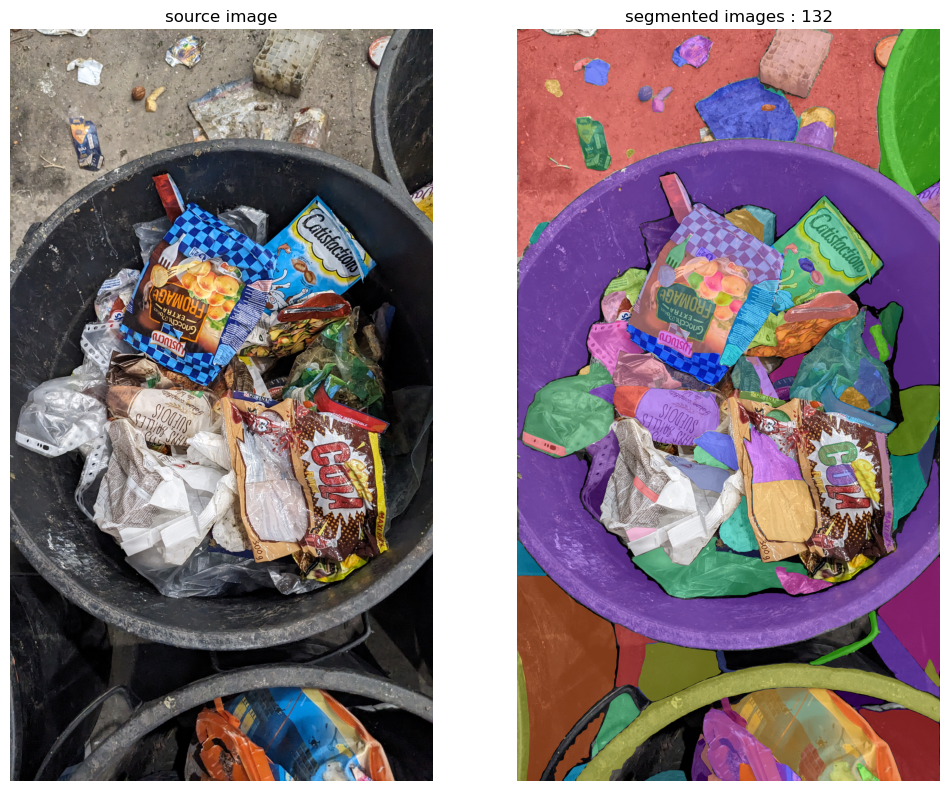

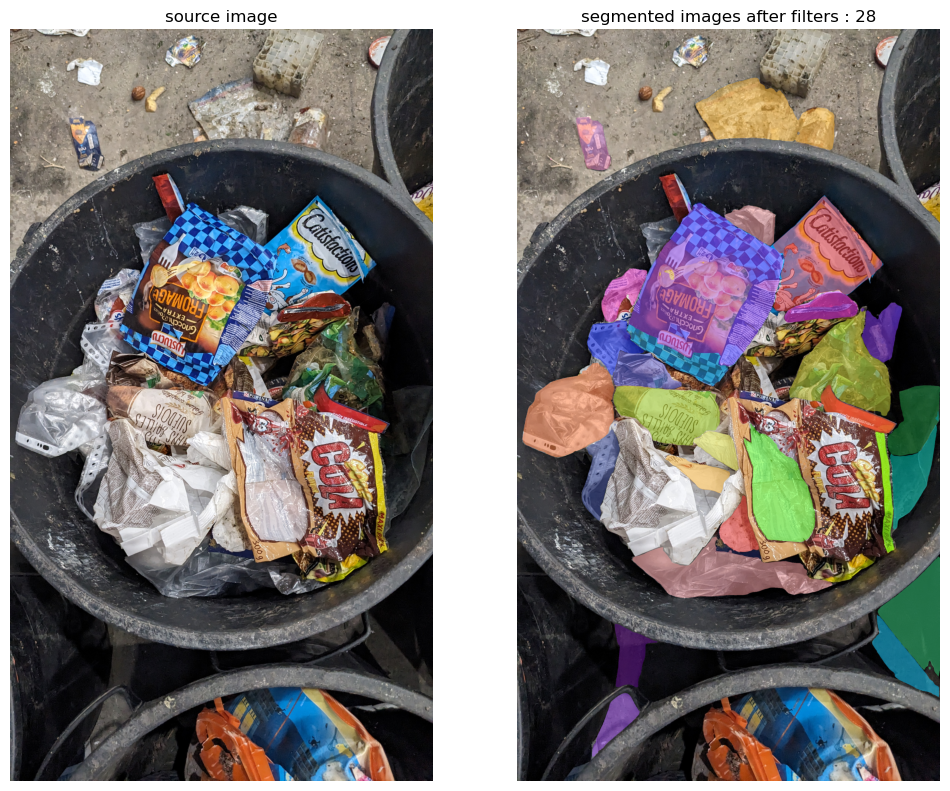

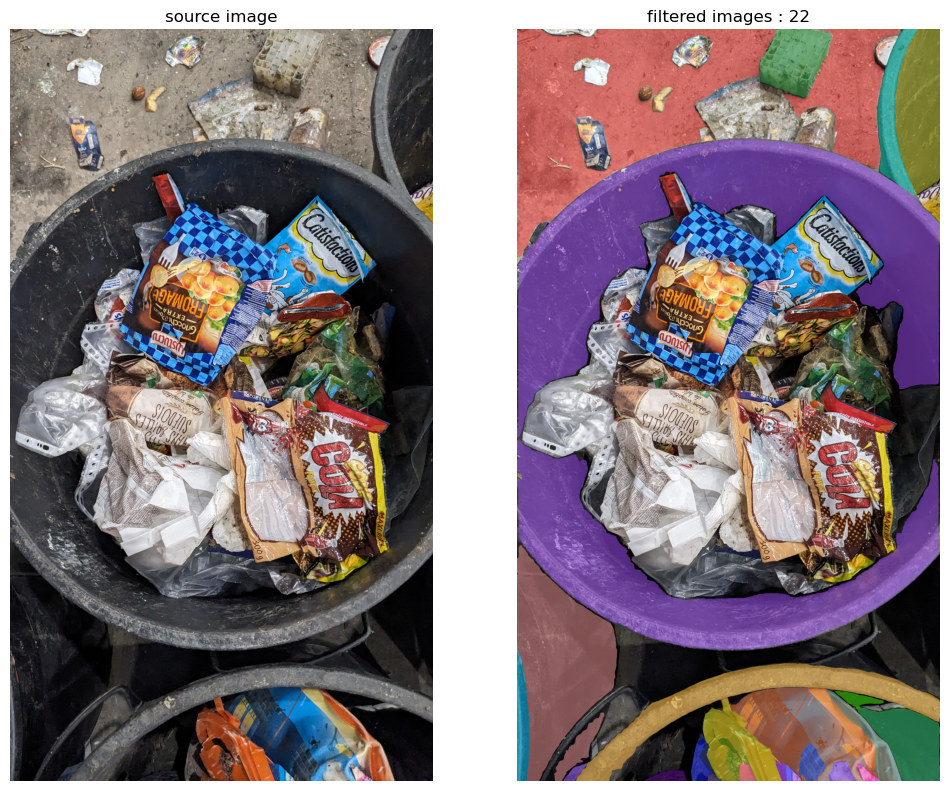

In [9]:
def plot_images_and_masks(image_bgr,sam_result,title = 'segmented images'):
    mask_annotator = sv.MaskAnnotator(color_lookup=sv.ColorLookup.INDEX)
    detections = sv.Detections.from_sam(sam_result=sam_result)
    nb_detections = len(sam_result)
    annotated_image = mask_annotator.annotate(scene=image_bgr.copy(), detections=detections)
    sv.plot_images_grid(
        images=[image_bgr, annotated_image],
        grid_size=(1, 2),
        titles=['source image', f'{title} : {nb_detections}']
    )
    


plot_images_and_masks(image_bgr,sam_result,title = 'segmented images')
plot_images_and_masks(image_bgr,fsam_result,title = 'segmented images after filters')
#plot_images_and_masks(image_bgr,bbox_filtered,title = 'segmented images after bbox filters')
#plot_images_and_masks(image_bgr,bp_filtered,title = 'segmented images after bp filters')
plot_images_and_masks(image_bgr,filtered,title = 'filtered images')

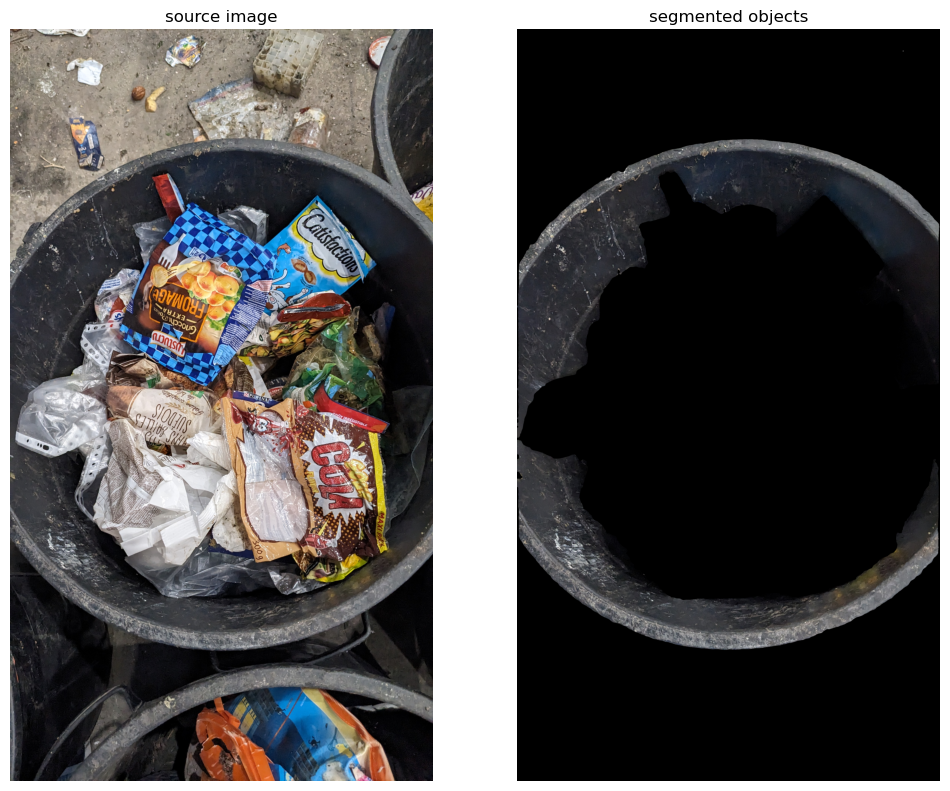

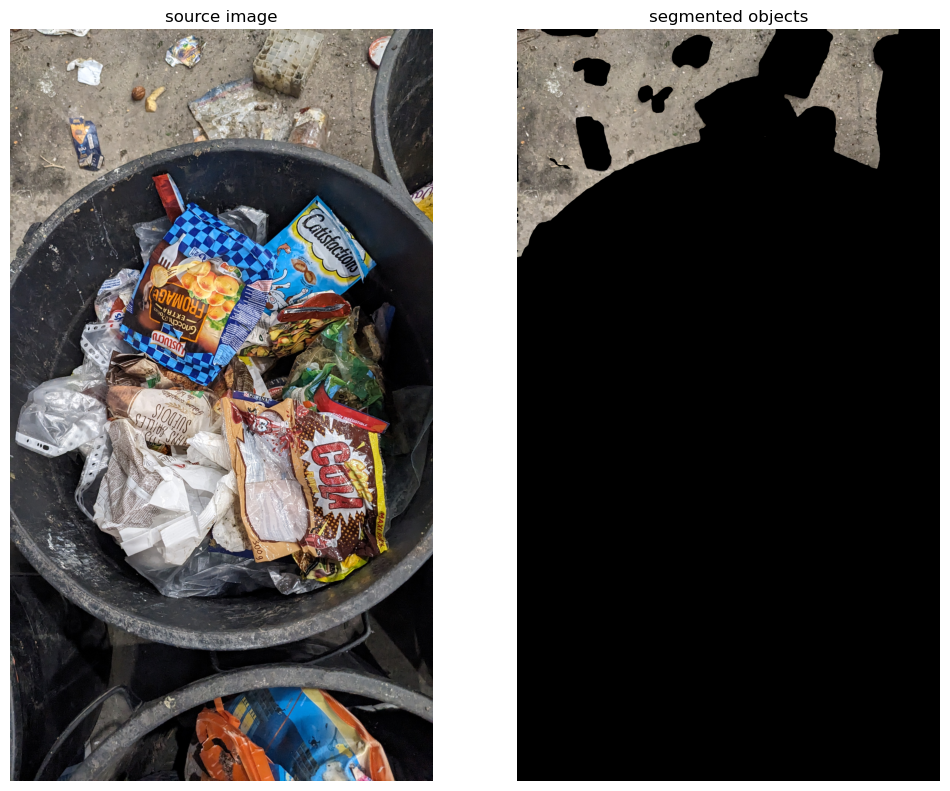

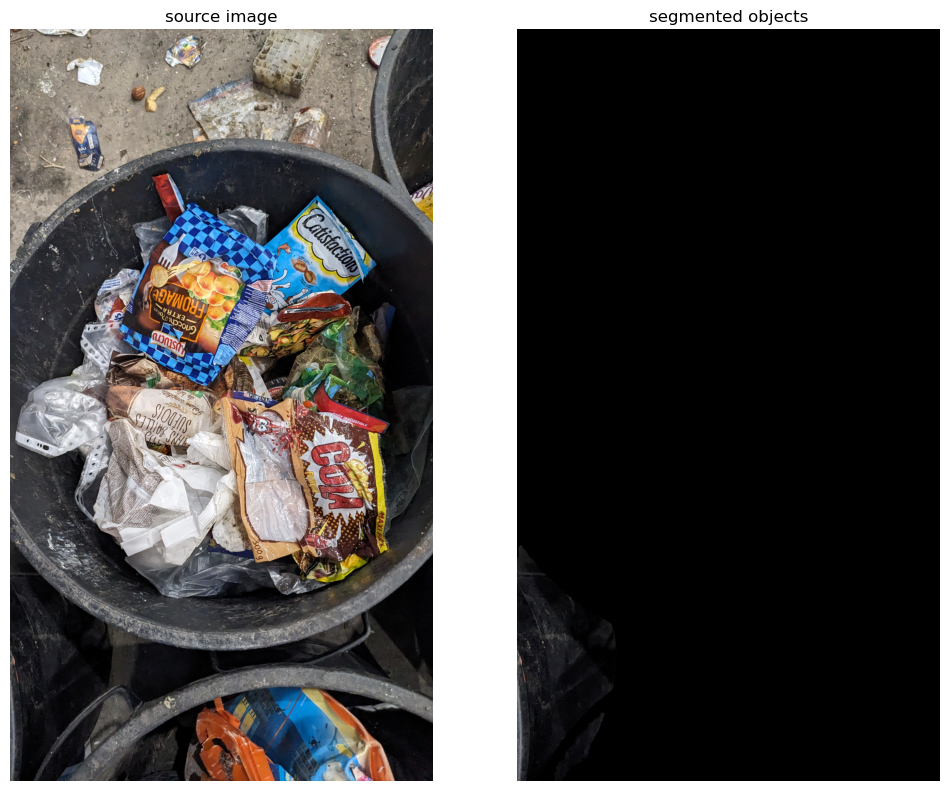

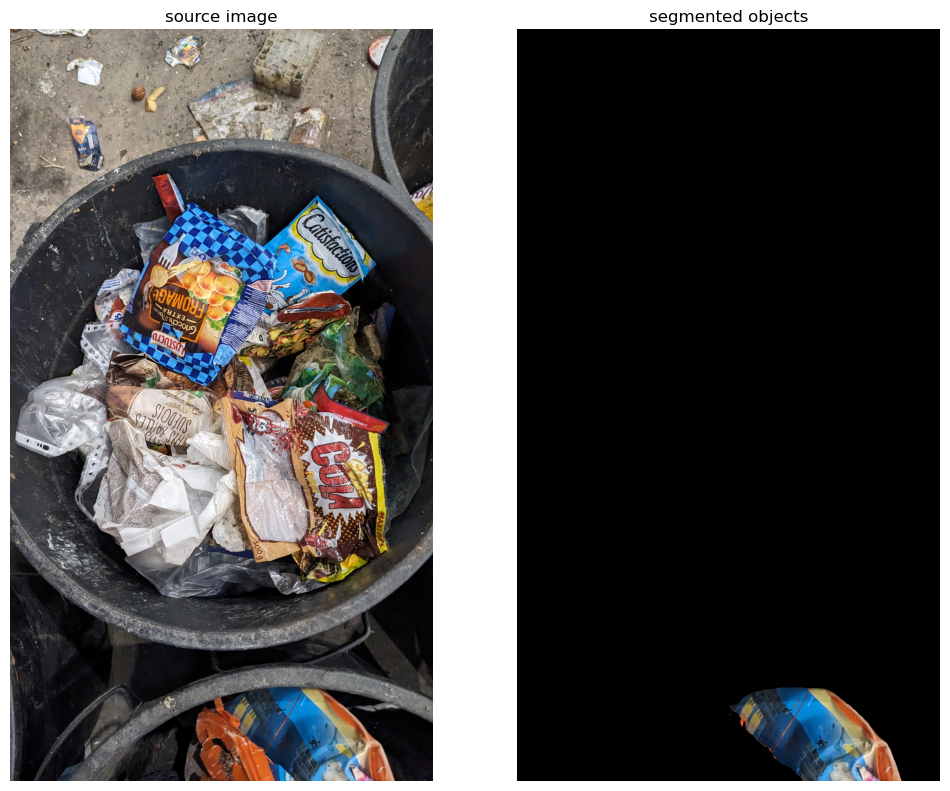

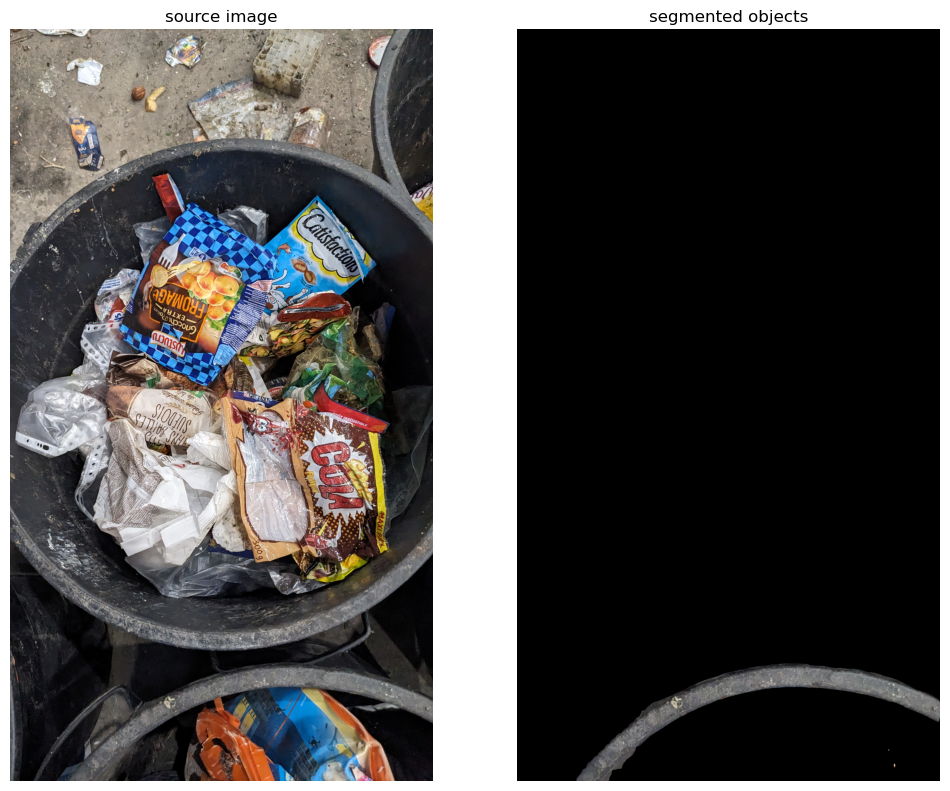

...

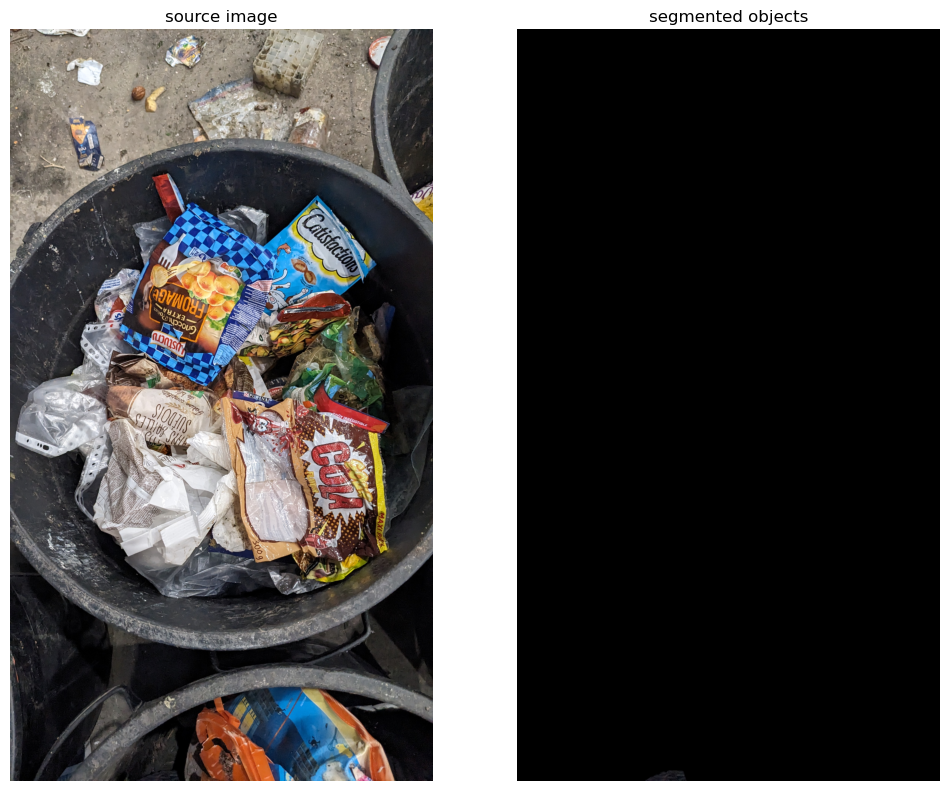

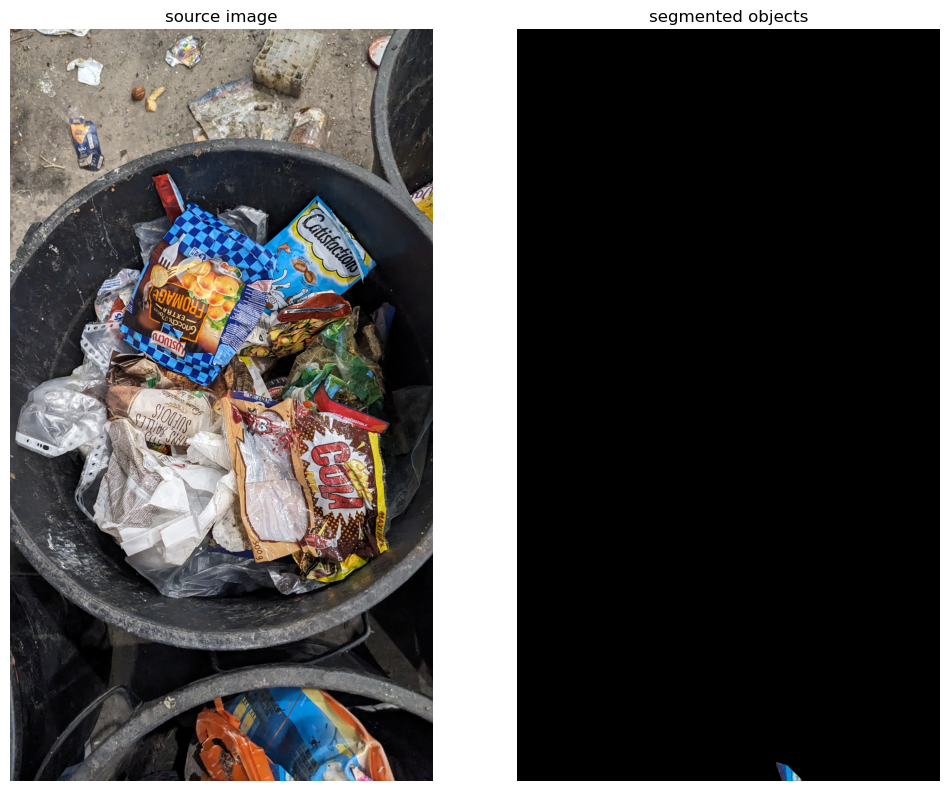

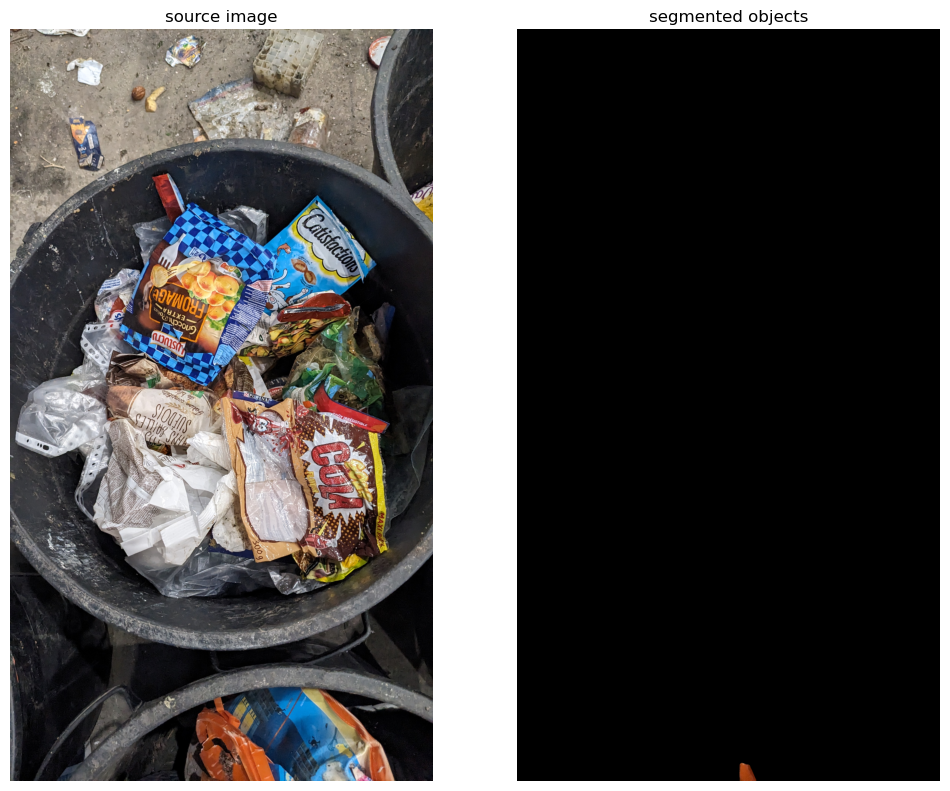

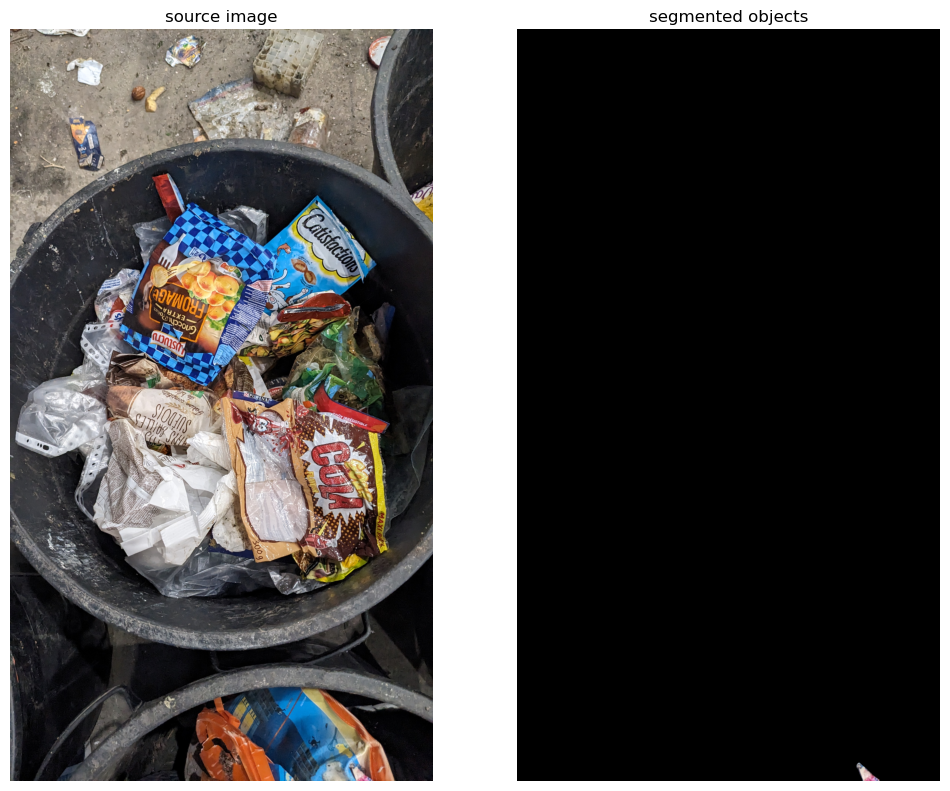

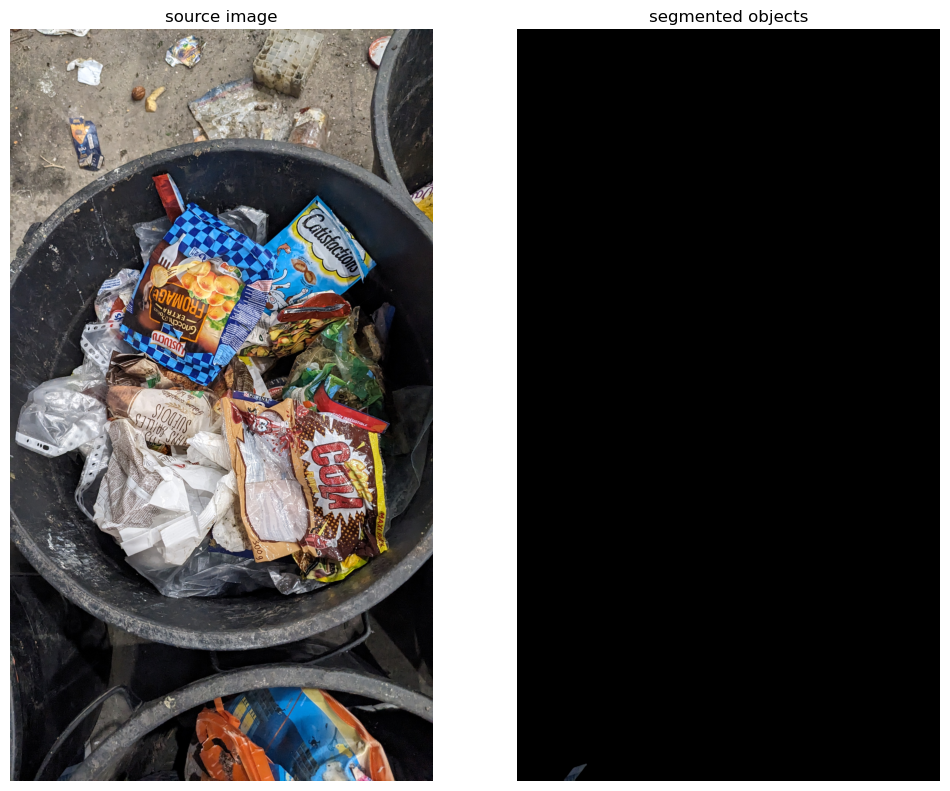

In [10]:
import numpy as np

def plot_all_masks(image_bgr,sam_result):
    

    masks = [
        mask['segmentation']
        for mask
        in sorted(sam_result, key=lambda x: x['area'], reverse=True)
    ]
    for i in range(len(masks)):
        new_image_array = apply_mask_and_create_image(masks[i], image_rgb)

            # Convert the result to an image and save or display it
        new_image = cv2.cvtColor(new_image_array, cv2.COLOR_RGB2BGR)
        #save_path = os.path.join("segments_dir", f'{i}.jpg')
        #cv2.imwrite(save_path, new_image)
        sv.plot_images_grid(
            images=[image_bgr, new_image],
            grid_size=(1, 2),
            titles=['source image', 'segmented objects']
        )

plot_all_masks(image_bgr,filtered)